<a href="https://colab.research.google.com/github/akashe/UnsupervisedLearning/blob/master/GANs/DCGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

The idea of this notebook is to get my hands dirty with GANs. In this notebook, we will train a GAN to create new celebrity faces. We will be trying DCGAN.

This notebook is highly influenced from official Pytorch GAN tutorial at
https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html


Experimentation:

1) When I tried DCGAN with original dimensions of images in celeb Faces dataset. The model didn't train. Discriminator classified perfectly and generator loss was around 80 and not changing after 1 epoch. This issue is covered in . https://github.com/pytorch/examples/issues/70 . It seems when the dims are higher DCGAN doesn't work.

2) Retrying experiment with 64*64 size. 

In [1]:
import torch
import random
import torch.optim as optim
from torchvision import datasets
import torchvision.transforms as transforms
import numpy as np
import torchvision.utils as vutils
import matplotlib.animation as animation
import torch.nn as nn

In [2]:
manual_seed = 7
random.seed(manual_seed)
torch.manual_seed(manual_seed)

In [3]:
%%bash
# Dataset location: https://drive.google.com/drive/folders/0B7EVK8r0v71pTUZsaXdaSnZBZzg
# Filename: img_align_celeba.zip
# Put curl command to download dataset
curl 'https://doc-10-6s-docs.googleusercontent.com/docs/securesc/p4sru7ol08po062mmkpi0bdj6h2et4r2/tg5bdr79ckp8so87fkbaml2k85sojidi/1610026425000/13182073909007362810/04849897259469428752/0B7EVK8r0v71pZjFTYXZWM3FlRnM?e=download&authuser=0&nonce=hu4quaqpop1kq&user=04849897259469428752&hash=51s5s41h9t5kdcj5ttr0ns8m76oaad9l' -H 'User-Agent: Mozilla/5.0 (X11; Ubuntu; Linux x86_64; rv:83.0) Gecko/20100101 Firefox/83.0' -H 'Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,*/*;q=0.8' -H 'Accept-Language: en-US,en;q=0.5' --compressed -H 'Connection: keep-alive' -H 'Cookie: AUTH_e7atjhvgn9ndg9fht5rkrab7e5gjovol_nonce=hu4quaqpop1kq; _ga=GA1.2.112930018.1603464134; s_fid=6A8C10E5F220521B-2291C1BCD736959B; s_cc=true' -H 'Upgrade-Insecure-Requests: 1' -H 'TE: Trailers' -o celeb.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 1376M    0 1376M    0     0  68.5M      0 --:--:--  0:00:20 --:--:-- 74.6M


In [4]:
%%bash
mkdir /content/celeb_data_folder
unzip /content/celeb.zip -d /content/celeb_data_folder

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [5]:
# Total Number of images
%%bash
ls /content/celeb_data_folder/img_align_celeba | wc -l

202599


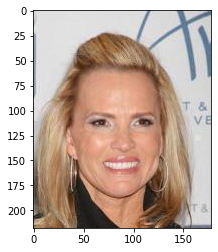

In [6]:
# Check a random image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
img = mpimg.imread("/content/celeb_data_folder/img_align_celeba/173822.jpg")
imgplot = plt.imshow(img)
plt.show()

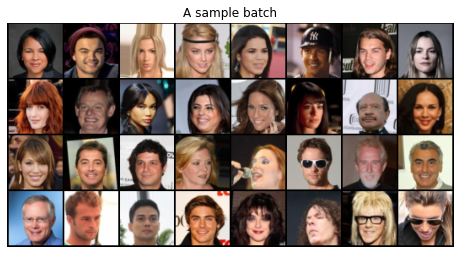

In [7]:
# Create a dataset

image_size = 64
batch_size = 128
workers = 2

dataset = datasets.ImageFolder(root="/content/celeb_data_folder/",\
                                    transform=transforms.Compose([
                                    transforms.Resize(image_size),
                                    transforms.CenterCrop(image_size),
                                    transforms.ToTensor(),
                                    transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))                              
                                    ]))

dataloader = torch.utils.data.DataLoader(dataset,batch_size=batch_size,shuffle=True,num_workers=workers)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Printing a batch
print_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("A sample batch")
plt.imshow(np.transpose(vutils.make_grid(print_batch[0].to(device),padding=2,normalize=True).cpu(),(1,2,0)))

In [8]:
print_batch[0].shape

torch.Size([32, 3, 64, 64])

In [9]:
# class Generator(nn.Module):
#   def __init__(self, input_dims,starting_channels=1024,end_channels=3):
#     super().__init__()
#     '''
#     input_dims: size of the latent vector
#     starting channels: number of channels in the first deconvolution step

#     We will be upscalling a vector of size input_dims to the image dims [218,178]
#     '''
    
#     self.network = nn.Sequential(
#         # First deconvolution : input_size -> [N,1024,6,5]
#         nn.ConvTranspose2d(input_dims,starting_channels,[6,5],1,0,bias=False),
#         nn.BatchNorm2d(starting_channels),
#         nn.ReLU(True),
#         #Second deconvolution: [N,1024,6,5] -> [N,512,13,11]
#         nn.ConvTranspose2d(starting_channels,int(starting_channels/2),4,2,1,output_padding=(1,1),bias=False),
#         nn.BatchNorm2d(int(starting_channels/2)),
#         nn.ReLU(True),
#         # Third deconvolution: [N,512,13,11] -> [N,256,27,22]
#         nn.ConvTranspose2d(int(starting_channels/2),int(starting_channels/4),4,2,1,output_padding=(1,0),bias=False),
#         nn.BatchNorm2d(int(starting_channels/4)),
#         nn.ReLU(True),
#         # Fourth deconvolution: [N,256,27,22] -> [N,128,54,44] 
#         nn.ConvTranspose2d(int(starting_channels/4),int(starting_channels/8),4,2,1,bias=False),
#         nn.BatchNorm2d(int(starting_channels/8)),
#         nn.ReLU(True),
#         # Fifth deconvlution: [N,128,54,44] -> [N,64,109,89] 
#         nn.ConvTranspose2d(int(starting_channels/8),int(starting_channels/16),4,2,1,output_padding=(1,1),bias=False),
#         nn.BatchNorm2d(int(starting_channels/16)),
#         nn.ReLU(True),
#         # Final deconvolution: [N,64,109,89] -> [N,3,218,178]
#         nn.ConvTranspose2d(int(starting_channels/16),end_channels,4,2,1,bias=False),
#         nn.Tanh()
#     )
#   def forward(self,input):
#     return self.network(input)

In [10]:
class Generator(nn.Module):
  def __init__(self, input_dims,starting_channels=1024,end_channels=3):
    super().__init__()
    '''
    input_dims: size of the latent vector
    starting channels: number of channels in the first deconvolution step

    We will be upscalling a vector of size input_dims to the image dims [218,178]
    '''
    
    self.network = nn.Sequential(
        # First deconvolution : input_size -> [N,1024,4,4]
        nn.ConvTranspose2d(input_dims,starting_channels,4,1,0,bias=False),
        nn.BatchNorm2d(starting_channels),
        nn.ReLU(True),
        #Second deconvolution: [N,1024,4,4] -> [N,512,8,8]
        nn.ConvTranspose2d(starting_channels,int(starting_channels/2),4,2,1,bias=False),
        nn.BatchNorm2d(int(starting_channels/2)),
        nn.ReLU(True),
        # Third deconvolution: [N,512,8,8] -> [N,256,16,16]
        nn.ConvTranspose2d(int(starting_channels/2),int(starting_channels/4),4,2,1,bias=False),
        nn.BatchNorm2d(int(starting_channels/4)),
        nn.ReLU(True),
        # Fourth deconvolution: [N,256,16,16] -> [N,128,32,32] 
        nn.ConvTranspose2d(int(starting_channels/4),int(starting_channels/8),4,2,1,bias=False),
        nn.BatchNorm2d(int(starting_channels/8)),
        nn.ReLU(True),
        # Fifth deconvlution: [N,128,32,32] -> [N,3,64,64] 
        nn.ConvTranspose2d(int(starting_channels/8),end_channels,4,2,1,bias=False),
        nn.Tanh()
    )
  def forward(self,input):
    return self.network(input)

In [11]:
# class Discriminator(nn.Module):
#   def __init__(self,in_channels=3,channels =64):
#     '''
#     Discriminate which is trained to find whether an image is real or fake
#     '''
#     super().__init__()
#     self.network = nn.Sequential(
#       # First convolution: [N,3,218,178] -> [N,64,109,89]
#       nn.Conv2d(in_channels,channels,4,2,1,bias=False),
#       nn.LeakyReLU(0.2,inplace=True),
#       # Second convoltion: [N,64,109,89] -> [N,128,54,44]
#       nn.Conv2d(channels,channels*2,4,2,1,bias=False),
#       nn.BatchNorm2d(channels*2),
#       nn.LeakyReLU(0.2,inplace=True),
#       # Third convolution: [N,128,54,44] -> [N,256,27,22]
#       nn.Conv2d(channels*2,channels*4,4,2,1,bias=False),
#       nn.BatchNorm2d(channels*4),
#       nn.LeakyReLU(0.2,inplace=True),
#       # Fourth convolution: [N,256,27,22] -> [N,512,13,11]
#       nn.Conv2d(channels*4,channels*8,4,2,1,bias=False),
#       nn.BatchNorm2d(channels*8),
#       nn.LeakyReLU(0.2,inplace=True),
#       # Fith convolution: [N,512,13,11] -> [N,1028,6,5]
#       nn.Conv2d(channels*8,channels*16,4,2,1,bias=False),
#       nn.BatchNorm2d(channels*16),
#       nn.LeakyReLU(0.2,inplace=True),
#       # Converting to predictions
#       nn.Conv2d(channels*16,1,[6,5],1,0,bias=False),
#       nn.Sigmoid()
#     )
#   def forward(self,input):
#     return self.network(input)

In [12]:
class Discriminator(nn.Module):
  def __init__(self,in_channels=3,channels =64):
    '''
    Discriminate which is trained to find whether an image is real or fake
    '''
    super().__init__()
    self.network = nn.Sequential(
      # First convolution: [N,3,64,64] -> [N,64,32,32]
      nn.Conv2d(in_channels,channels,4,2,1,bias=False),
      nn.LeakyReLU(0.2,inplace=True),
      # Second convoltion: [N,64,32,32] -> [N,128,16,16]
      nn.Conv2d(channels,channels*2,4,2,1,bias=False),
      nn.BatchNorm2d(channels*2),
      nn.LeakyReLU(0.2,inplace=True),
      # Third convolution: [N,128,16,16] -> [N,256,8,8]
      nn.Conv2d(channels*2,channels*4,4,2,1,bias=False),
      nn.BatchNorm2d(channels*4),
      nn.LeakyReLU(0.2,inplace=True),
      # Fourth convolution: [N,256,8,8] -> [N,512,4,4]
      nn.Conv2d(channels*4,channels*8,4,2,1,bias=False),
      nn.BatchNorm2d(channels*8),
      nn.LeakyReLU(0.2,inplace=True),
      # Fith convolution: [N,512,4,4] -> [N,1,1,1]
      nn.Conv2d(channels*8,1,4,1,0,bias=False),
      nn.Sigmoid()
    )
  def forward(self,input):
    return self.network(input)

In [13]:
def weights_init(m):
  classname = m.__class__.__name__
  if classname.find('Conv')!= -1:
    nn.init.normal_(m.weight.data,0.0,0.02)
  elif classname.find('BatchNorm')!= -1:
    nn.init.normal_(m.weight.data,1.0,0.02)
    nn.init.constant_(m.bias.data,0)

In [14]:
latent_vector_size = 100
lr = 0.0002
beta1 = 0.5

criterion = nn.BCELoss()

# Noise vector to check progress of Generator
fixed_noise = torch.randn(32,latent_vector_size,1,1,device=device)

# Defining labels
real_label = 1.
fake_label = 0.

# initialize Generators and Discriminators
generator = Generator(latent_vector_size).to(device)
generator.apply(weights_init)

discriminator = Discriminator().to(device)
discriminator.apply(weights_init)

# Optimizers
optimizerG = optim.Adam(generator.parameters(),lr=lr,betas=(beta1,0.999))
optimizerD = optim.Adam(discriminator.parameters(),lr=lr,betas=(beta1,0.999))

In [15]:
# Training Loop
num_epochs = 5


# Lists to keep progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Start Training Loop...")
for epoch in range(num_epochs):
  # Iterating over batches
  for i,data in enumerate(dataloader):
    ###########
    # Training discriminator
    ###########
    discriminator.zero_grad()

    # Training D with real data
    real = data[0].to(device)
    batch_size = real.size(0)
    label = torch.ones(batch_size,device=device)
    # passing real batch through discriminator
    output = discriminator(real).view(-1)
    # print(vars(discriminator))
    errD_real = criterion(output,label)
    # backpropagating this error
    errD_real.backward()
    D_x = output.mean().item()

    # Train D with generated data
    noise = torch.randn(batch_size,latent_vector_size,1,1,device=device)
    # Generate fake images
    fake = generator(noise)
    label.fill_(fake_label)
    output = discriminator(fake.detach()).view(-1)
    # Error on fake images
    errD_fake = criterion(output,label)
    # backpropagating this error
    errD_fake.backward()
    D_G_z1 = output.mean().item()
    # Total error for discriminator
    errD = errD_real + errD_fake
    # optim step
    optimizerD.step()

    ########
    # Training Generator
    ########
    generator.zero_grad()
    label.fill_(real_label) # Since generator improves if it can fool discriminator so fake labels are real for generator

    output = discriminator(fake).view(-1)
    # Error for G
    errG = criterion(output,label)
    # backpropagate this error thorugh discriminator to generator
    errG.backward()
    D_G_z2 = output.mean().item()
    optimizerG.step()

    # Training stats
    if i%50 ==0:
      print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
      
    G_losses.append(errG.item())
    D_losses.append(errD.item())

    if (iters%300 ==0) or ((epoch==num_epochs-1) and (i==len(dataloader)-1)):
      with torch.no_grad():
        fake=generator(fixed_noise).detach().cpu()
      img_list.append(vutils.make_grid(fake,padding=2,normalize=True))
    iters +=1


Start Training Loop...
[0/5][0/6332]	Loss_D: 1.1985	Loss_G: 6.5737	D(x): 0.6723	D(G(z)): 0.4460 / 0.0016
[0/5][50/6332]	Loss_D: 0.4125	Loss_G: 6.1324	D(x): 0.8891	D(G(z)): 0.0812 / 0.0058
[0/5][100/6332]	Loss_D: 0.4784	Loss_G: 9.2148	D(x): 0.8017	D(G(z)): 0.0002 / 0.0002
[0/5][150/6332]	Loss_D: 0.6616	Loss_G: 2.6680	D(x): 0.8118	D(G(z)): 0.1802 / 0.1160
[0/5][200/6332]	Loss_D: 2.1023	Loss_G: 3.2138	D(x): 0.2630	D(G(z)): 0.0749 / 0.1282
[0/5][250/6332]	Loss_D: 1.5355	Loss_G: 1.4020	D(x): 0.3473	D(G(z)): 0.0561 / 0.2945
[0/5][300/6332]	Loss_D: 0.8730	Loss_G: 5.1985	D(x): 0.8590	D(G(z)): 0.4484 / 0.0121
[0/5][350/6332]	Loss_D: 1.2556	Loss_G: 2.7455	D(x): 0.5937	D(G(z)): 0.3794 / 0.1062
[0/5][400/6332]	Loss_D: 1.3211	Loss_G: 4.4784	D(x): 0.8098	D(G(z)): 0.5763 / 0.0200
[0/5][450/6332]	Loss_D: 0.7507	Loss_G: 3.5069	D(x): 0.8939	D(G(z)): 0.4173 / 0.0447
[0/5][500/6332]	Loss_D: 0.9635	Loss_G: 4.6815	D(x): 0.8617	D(G(z)): 0.4870 / 0.0169
[0/5][550/6332]	Loss_D: 1.0978	Loss_G: 5.4289	D(x): 0.85

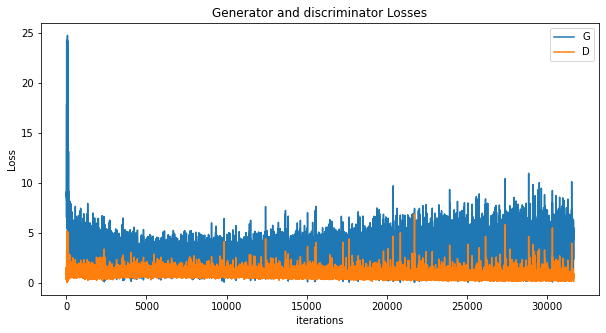

In [16]:
# Plotting discriminator and generator losses
plt.figure(figsize=(10,5))
plt.title("Generator and discriminator Losses")
plt.plot(G_losses,label='G')
plt.plot(D_losses,label='D')
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

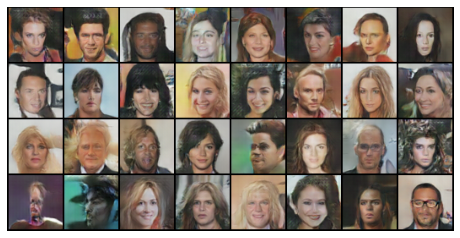

In [22]:
# Evolution of generator
from IPython.display import HTML
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)),animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig,ims,interval=2000,repeat_delay=2000,blit=True)

HTML(ani.to_jshtml())